# Assignment 14

# **Random Forest**

In [83]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, classification_report
import matplotlib.pyplot as plt
from sklearn import tree
import seaborn as sns
from sklearn.preprocessing import StandardScaler
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 1000
sns.set_theme(style='darkgrid', palette='rainbow')
import warnings
warnings.filterwarnings('ignore')
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.model_selection import train_test_split

In [85]:
!pip install --upgrade scikit-learn

 Load the dataset

In [56]:
file_path = "random_glass.xlsx"  # Update with the correct file path if necessary
data = pd.read_excel(file_path)

Exploratory Data Analysis (EDA)

In [57]:
data


,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
0,1.52101,13.64,4.49,1.10,71.78,0.06,8.75,0.00,0.0,1
1,1.51761,13.89,3.60,1.36,72.73,0.48,7.83,0.00,0.0,1
2,1.51618,13.53,3.55,1.54,72.99,0.39,7.78,0.00,0.0,1
3,1.51766,13.21,3.69,1.29,72.61,0.57,8.22,0.00,0.0,1
4,1.51742,13.27,3.62,1.24,73.08,0.55,8.07,0.00,0.0,1
...,...,...,...,...,...,...,...,...,...,...
209,1.51623,14.14,0.00,2.88,72.61,0.08,9.18,1.06,0.0,7
210,1.51685,14.92,0.00,1.99,73.06,0.00,8.40,1.59,0.0,7
211,1.52065,14.36,0.00,2.02,73.42,0.00,8.44,1.64,0.0,7
212,1.51651,14.38,0.00,1.94,73.61,0.00,8.48,1.57,0.0,7


In [58]:
data.describe()

,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
count,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000,214.000000
mean,1.518365,13.407850,2.684533,1.444907,72.650935,0.497056,8.956963,0.175047,0.057009,2.780374
std,0.003037,0.816604,1.442408,0.499270,0.774546,0.652192,1.423153,0.497219,0.097439,2.103739
min,1.511150,10.730000,0.000000,0.290000,69.810000,0.000000,5.430000,0.000000,0.000000,1.000000
25%,1.516522,12.907500,2.115000,1.190000,72.280000,0.122500,8.240000,0.000000,0.000000,1.000000
50%,1.517680,13.300000,3.480000,1.360000,72.790000,0.555000,8.600000,0.000000,0.000000,2.000000
75%,1.519157,13.825000,3.600000,1.630000,73.087500,0.610000,9.172500,0.000000,0.100000,3.000000
max,1.533930,17.380000,4.490000,3.500000,75.410000,6.210000,16.190000,3.150000,0.510000,7.000000


In [59]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214 entries, 0 to 213
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   RI      214 non-null    float64
 1   Na      214 non-null    float64
 2   Mg      214 non-null    float64
 3   Al      214 non-null    float64
 4   Si      214 non-null    float64
 5   K       214 non-null    float64
 6   Ca      214 non-null    float64
 7   Ba      214 non-null    float64
 8   Fe      214 non-null    float64
 9   Type    214 non-null    int64  
dtypes: float64(9), int64(1)
memory usage: 16.8 KB


In [60]:
data.isna().sum()

,0
RI,0
Na,0
Mg,0
Al,0
Si,0
K,0
Ca,0
Ba,0
Fe,0
Type,0


In [63]:
data.replace(0,np.nan,inplace=True)

In [64]:
data.isna().sum()

,0
RI,0
Na,0
Mg,42
Al,0
Si,0
K,30
Ca,0
Ba,176
Fe,144
Type,0


In [65]:
from sklearn.impute import SimpleImputer

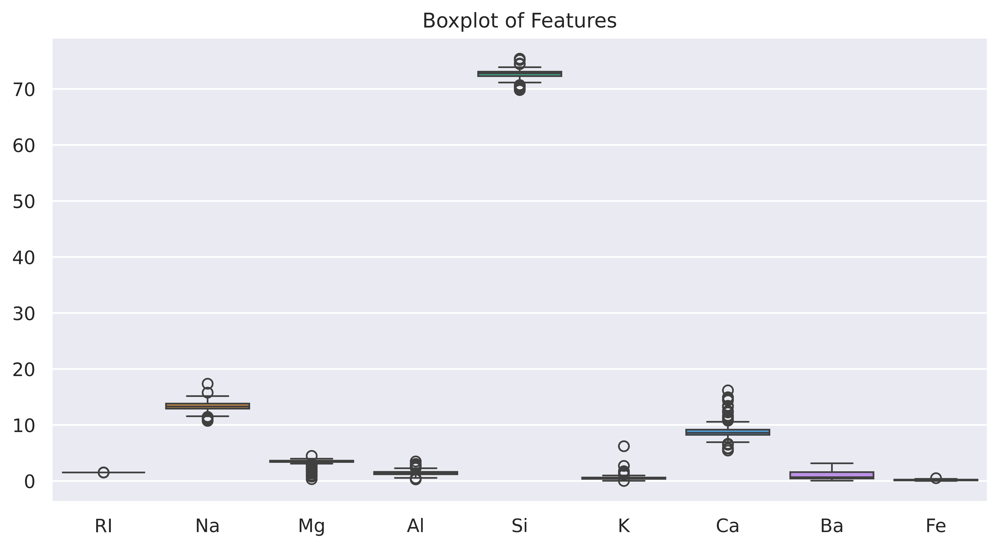

In [67]:
sns.boxplot(data=data.iloc[:, :-1]) # Outlier Detection
plt.title("Boxplot of Features")
plt.show()

 Data Visualization

In [68]:
plt.figure(figsize=(10, 8))
sns.heatmap(data.corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Heatmap")
plt.show()


In [69]:
sns.pairplot(data, hue="Type")  # Assuming "Type" is the target column
plt.show()

Data Preprocessing

In [71]:
imputer = SimpleImputer(strategy="mean")
data.iloc[:, :-1] = imputer.fit_transform(data.iloc[:, :-1])

In [72]:
data["Type"] = data["Type"].astype("category").cat.codes

In [74]:
scaler = StandardScaler() # Feature Scaling
X = scaler.fit_transform(data.iloc[:, :-1])
y = data.iloc[:, -1]

Random Forest Model Implementation

In [76]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

In [77]:
# Train Random Forest Classifier
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [78]:
# Model Evaluation
y_pred_rf = rf_model.predict(X_test)
print("\nRandom Forest Performance:")
print("Accuracy:", accuracy_score(y_test, y_pred_rf))
print("Classification Report:\n", classification_report(y_test, y_pred_rf))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_rf))


Random Forest Performance:
Accuracy: 0.8
Classification Report:
               precision    recall  f1-score   support

           0       0.79      0.90      0.84        21
           1       0.86      0.78      0.82        23
           2       1.00      0.40      0.57         5
           3       0.60      0.75      0.67         4
           4       1.00      0.67      0.80         3
           5       0.73      0.89      0.80         9

    accuracy                           0.80        65
   macro avg       0.83      0.73      0.75        65
weighted avg       0.82      0.80      0.80        65

Confusion Matrix:
 [[19  1  0  0  0  1]
 [ 2 18  0  2  0  1]
 [ 3  0  2  0  0  0]
 [ 0  1  0  3  0  0]
 [ 0  0  0  0  2  1]
 [ 0  1  0  0  0  8]]


In [88]:
bagging_model = BaggingClassifier(random_state=42)
bagging_model.fit(X_train, y_train)

# Make predictions
y_pred_bagging = bagging_model.predict(X_test)


In [89]:
boosting_model = AdaBoostClassifier(random_state=42)
boosting_model.fit(X_train, y_train)
y_pred_boosting = boosting_model.predict(X_test)

In [90]:
print("\nBagging Performance:")
print("Accuracy:", accuracy_score(y_test, y_pred_bagging))
print("Classification Report:\n", classification_report(y_test, y_pred_bagging))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_bagging))


Bagging Performance:
Accuracy: 0.7384615384615385
Classification Report:
               precision    recall  f1-score   support

           0       0.83      0.90      0.86        21
           1       0.83      0.65      0.73        23
           2       0.40      0.40      0.40         5
           3       0.60      0.75      0.67         4
           4       0.50      0.67      0.57         3
           5       0.70      0.78      0.74         9

    accuracy                           0.74        65
   macro avg       0.64      0.69      0.66        65
weighted avg       0.75      0.74      0.74        65

Confusion Matrix:
 [[19  2  0  0  0  0]
 [ 1 15  3  1  1  2]
 [ 3  0  2  0  0  0]
 [ 0  1  0  3  0  0]
 [ 0  0  0  0  2  1]
 [ 0  0  0  1  1  7]]


In [91]:

print("\nBoosting Performance:")
print("Accuracy:", accuracy_score(y_test, y_pred_boosting))
print("Classification Report:\n", classification_report(y_test, y_pred_boosting))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_boosting))


Boosting Performance:
Accuracy: 0.5076923076923077
Classification Report:
               precision    recall  f1-score   support

           0       0.56      0.67      0.61        21
           1       0.55      0.48      0.51        23
           2       0.00      0.00      0.00         5
           3       0.00      0.00      0.00         4
           4       0.00      0.00      0.00         3
           5       0.57      0.89      0.70         9

    accuracy                           0.51        65
   macro avg       0.28      0.34      0.30        65
weighted avg       0.45      0.51      0.47        65

Confusion Matrix:
 [[14  6  1  0  0  0]
 [ 7 11  3  1  0  1]
 [ 4  1  0  0  0  0]
 [ 0  2  0  0  0  2]
 [ 0  0  0  0  0  3]
 [ 0  0  0  0  1  8]]


While boosting trains the models sequentially, bagging trains all the models simultaneously. While boosting uses the errors from the previous model to reduce them the following time, increasing accuracy after each sequential model is trained, bagging uses the average of all the models learned to provide accuracy.

Preprocess the data by treating the outliers and handling missing numbers.Adjust the data to obtain the right training settings.Use metrics like precision, recall, and f1 score to assess the accuracy. For better feature selection, make use of row and column sampling as well.